In [2]:
import os
import glob
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import hdbscan
import module

from umap.umap_ import UMAP
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_extraction.text import TfidfVectorizer

# Input

In [2]:
external = pd.read_csv('data/external.csv', encoding='utf-8', encoding_errors='replace')
internal = pd.read_csv('data/internal.csv')

# converts lists and dictionaries in the columns
external = module.eval_as(external)
internal = module.eval_as(internal)

In [3]:
internal.sample()

,Z30_CALL_NO,frequency,users,users_weighed,yearly_frequency,yearly_loan_time,title,is_outlier,yearly_frequency_norm,frequency_norm
6074,Ca-DIZ 20-5710,4,"[I-52, I-50, I-579, I-686]","[I-50, I-52, I-579, I-686]","{2018: 2, 2014: 1, 2017: 1}","{2014: 1.0, 2017: 2.0, 2018: 3.0}",Gaspare Diziani,False,"{2016: 0.0, 2021: 0.0, 2018: 0.038461538461538...",0.007481


# Embedding 

In [9]:
# Identity tokenizer for tfidf
def identity_tokenizer(doc):
    return doc

# TFIDF and Embedding for a df
def embedding(df, title): 

    tfidf = TfidfVectorizer(tokenizer = identity_tokenizer, preprocessor= identity_tokenizer, token_pattern=None)
    users_weighed_tfidf = tfidf.fit_transform(df['users_weighed'])

    reducer = UMAP(n_components=2, metric='hamming', n_neighbors=50)
    emb = reducer.fit_transform(users_weighed_tfidf)

    scaler = MinMaxScaler(feature_range=(100, 900))  # Scale
    emb = scaler.fit_transform(emb)
    emb = emb.astype(int)
    module.plot_embedding(emb,title)

    df = df.assign(x=emb[:, 0], y=emb[:, 1])
    return df

def clustering(df): 
    
    hdb = hdbscan.HDBSCAN(
    # min_samples=1,
    min_cluster_size=20,  # 2 — which means 3 elements — is the smallest cluster size
    cluster_selection_epsilon=5,   # float, optional (default=0.0) A distance threshold. Clusters below this value will be merged.
    # gen_min_span_tree=False,
    # leaf_size=10, # int, optional (default=40) If using a space tree algorithm (kdtree, or balltree) the number of points ina leaf node of the tree. This does not alter the resulting clustering, but may have an effect on the runtime of the algorithm.
)
    embedding = df[['x', 'y']].to_numpy()
    hdb.fit(embedding)
    clusters = hdb.labels_

    df['cluster'] = clusters

    return df,hdb

# external = embedding(external, 'External')
# internal = embedding(internal, '')

# external, ext_hdb = clustering(external)
# internal, int_hdb = clustering(internal)





In [10]:
# Saved embedding for internals
internal = pd.read_csv('data/internal_embedding.csv', encoding='utf-8', encoding_errors='replace')
internal = module.eval_as(internal)
internal_clustered = internal[internal['cluster'] != -1]

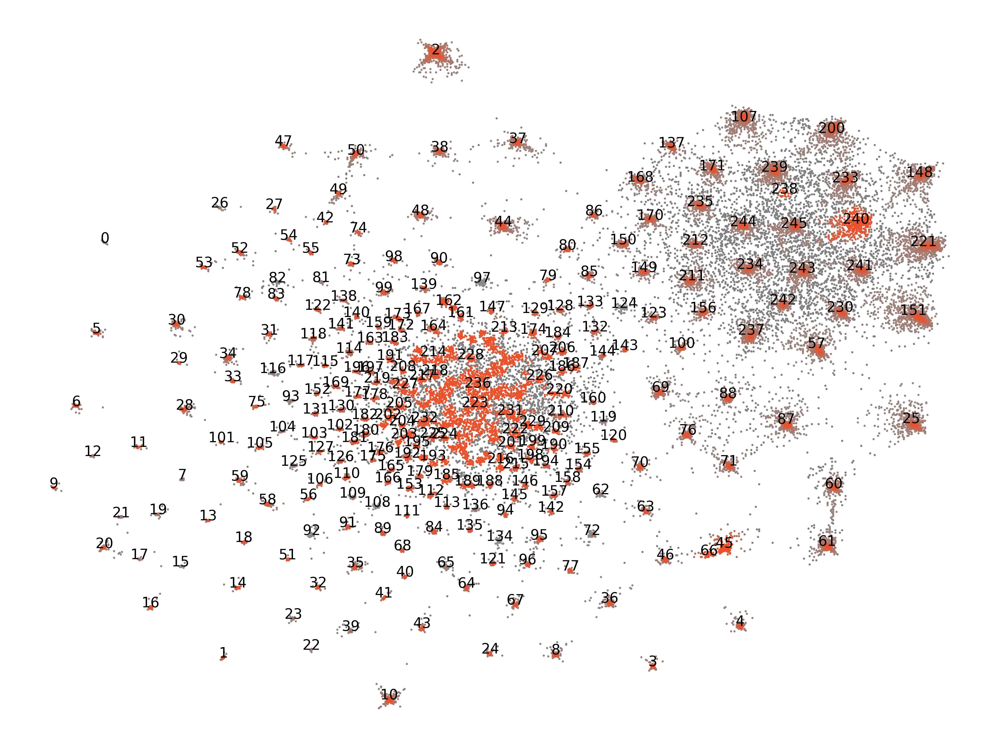

In [11]:
internal, int_hdb = clustering(internal)
module.plot_clustering(internal, int_hdb)

In [ ]:
# module.plot_clustering(external, ext_hdb)
# module.plot_clustering(internal, int_hdb)

# Analysis

In [ ]:
# Full bvb export for metadata
path = 'data/b3kat_export/'
files = glob.glob(os.path.join(path, '*.csv'))

li = []

for filename in files: 
    frame = pd.read_csv(filename, header=0)
    li.append(frame)

df_full = pd.concat(li, axis=0, ignore_index=True)

df_full= df_full[['id', 'lang', 'authors', 'parentId', 'title', 'subtitle', 'statement']] # Select columns here
df_full = df_full.drop_duplicates(subset=['id'])

external = external.merge(df_full, left_on='title', right_on='title', how='left')
external = external.drop_duplicates(subset=['Z30_CALL_NO'])

internal = internal.merge(df_full, left_on='title', right_on='title', how='left')
internal = internal.drop_duplicates(subset=['Z30_CALL_NO'])

In [11]:
# external_clustered = external[external['cluster'] != -1]
internal_clustered = internal[internal['cluster'] != -1]

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_3150/3369979605.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  external_clustered['Subject'] = external_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
/Users/hana/Documents/GitHub/BHVizData/thesis/src/module.py:146: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(x_values, y_values, s=2, c=color)


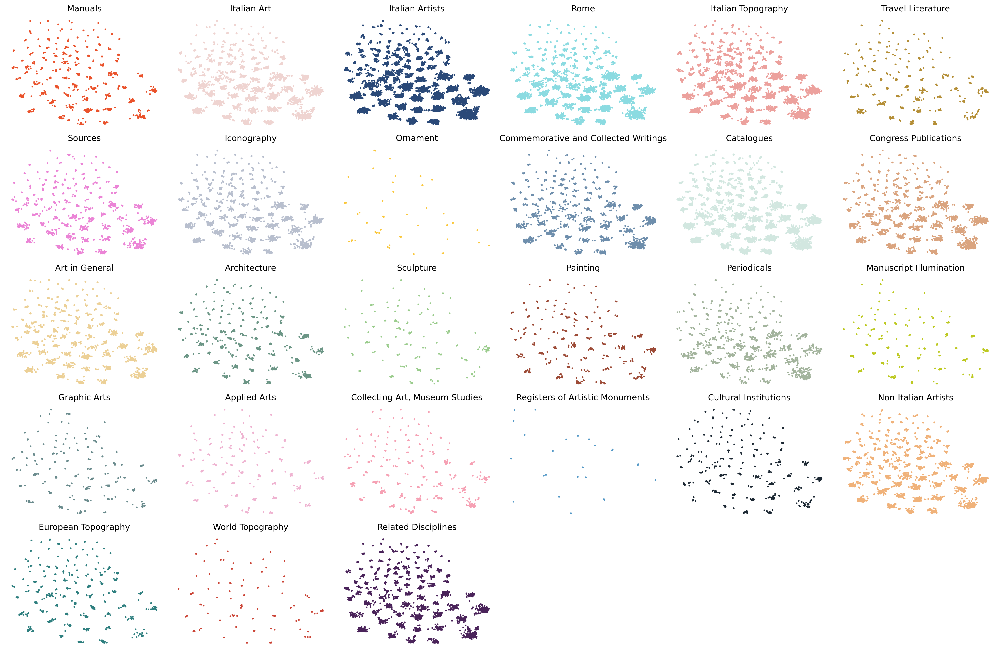

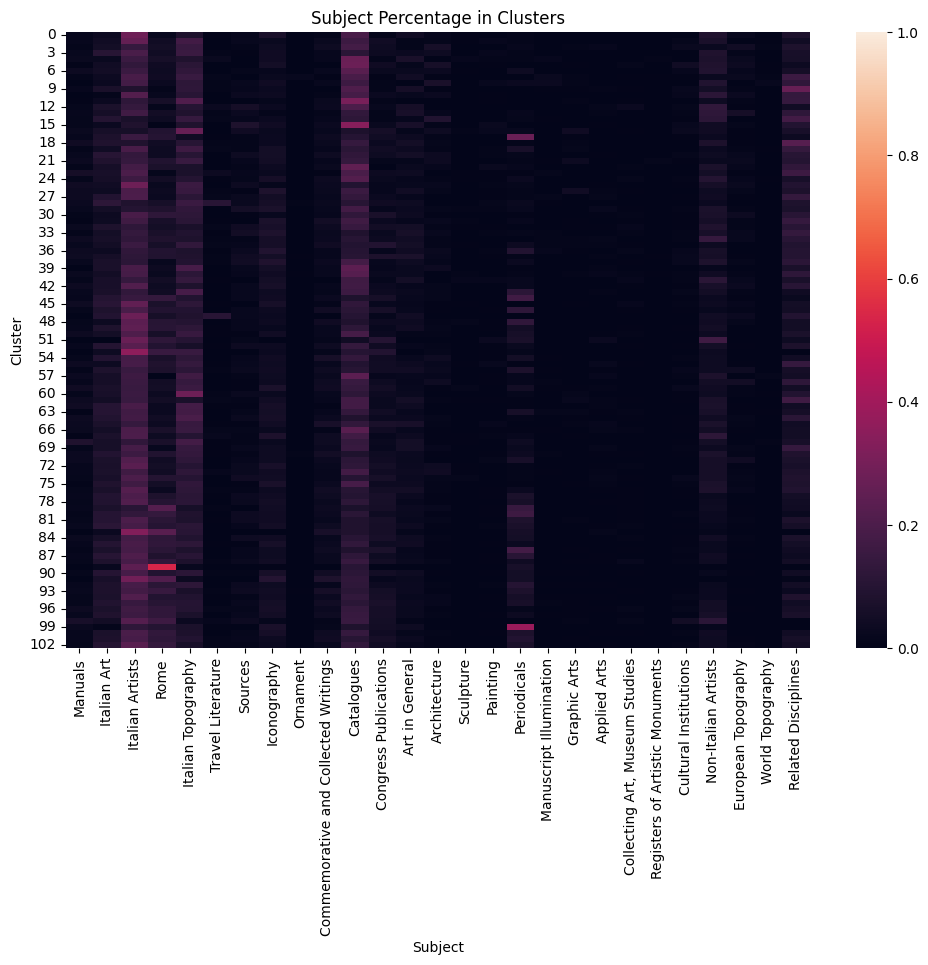

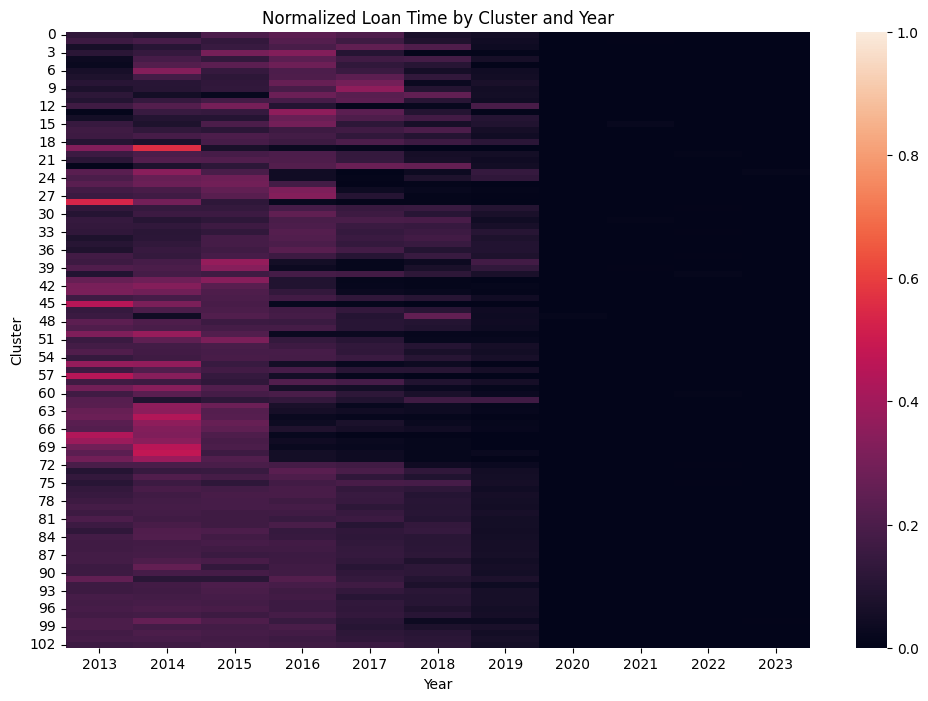

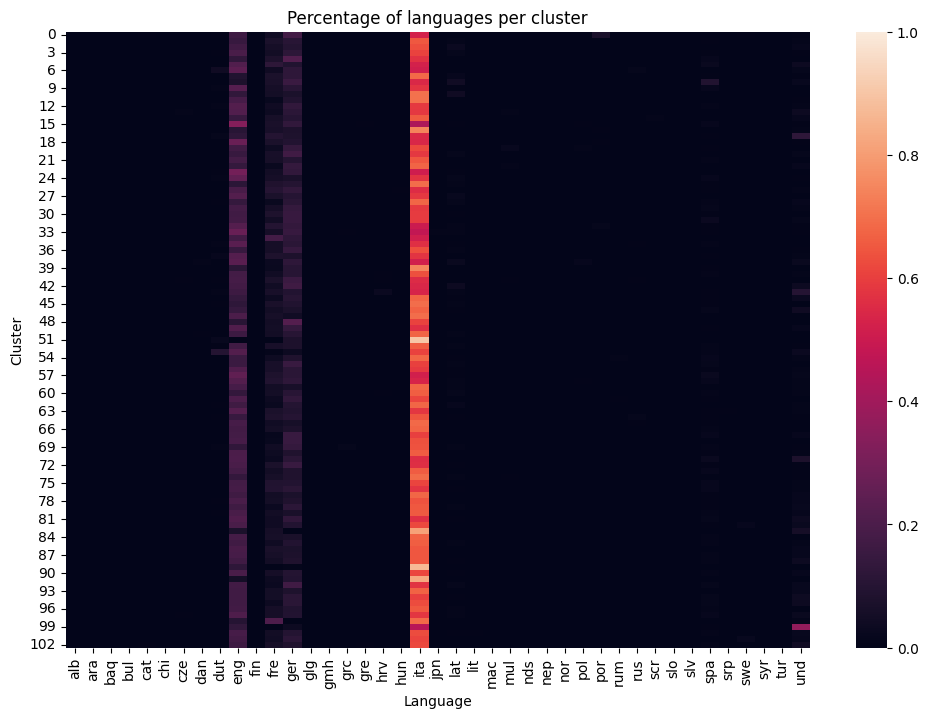

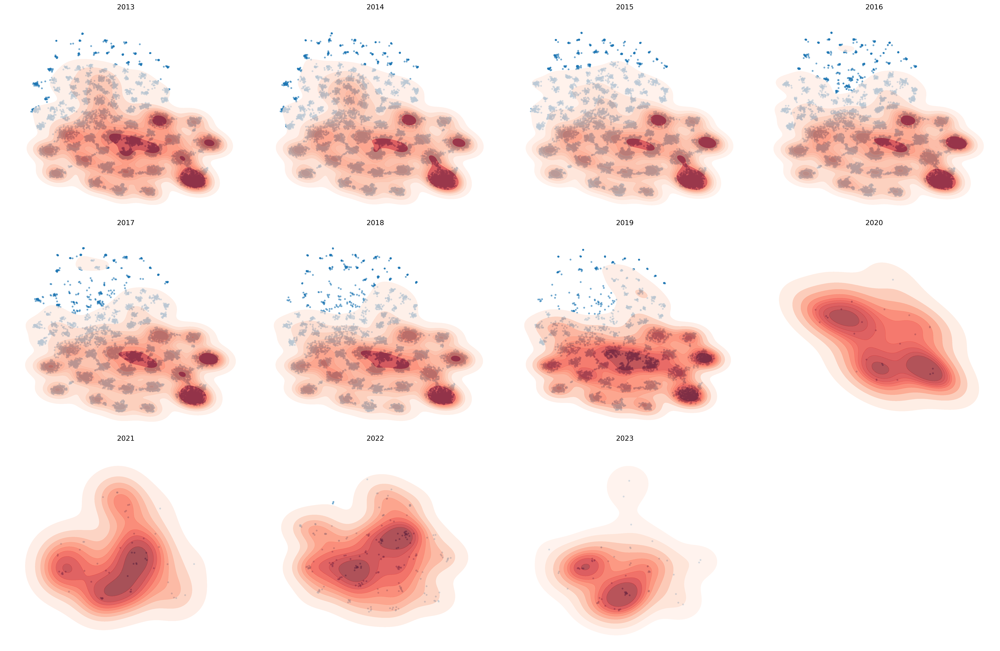

In [8]:
# external_clustered['Subject'] = external_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
# module.small_multiple_subject(external_clustered)
# module.subject_heatmap(external_clustered)
# module.temporality_heatmap(external_clustered)
# module.language_heatmap(external_clustered)
# module.plot_loan_density(external_clustered)

/var/folders/fs/xb9k_3m95gq0wjgk1kgw1nxr0000gn/T/ipykernel_7641/1015415126.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  internal_clustered['Subject'] = internal_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
/Users/hana/Documents/GitHub/BHVizData/thesis/src/module.py:150: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(x_values, y_values, s=2, c=color)


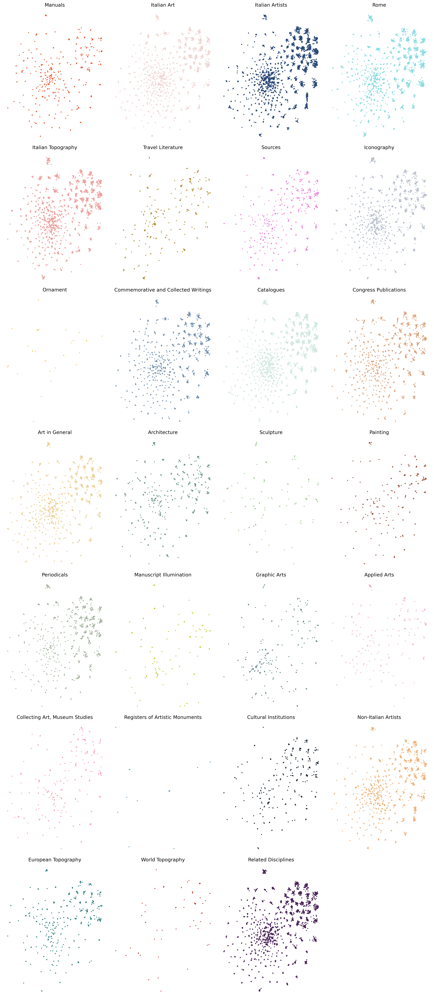

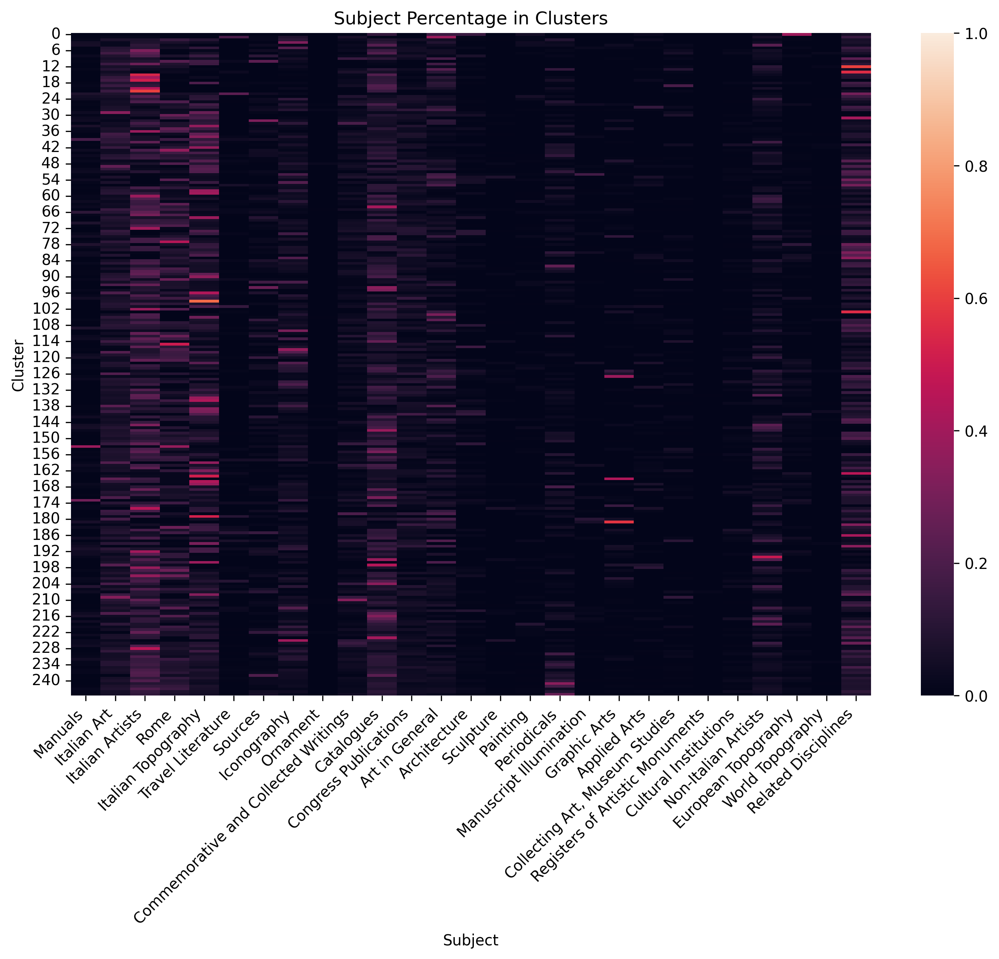

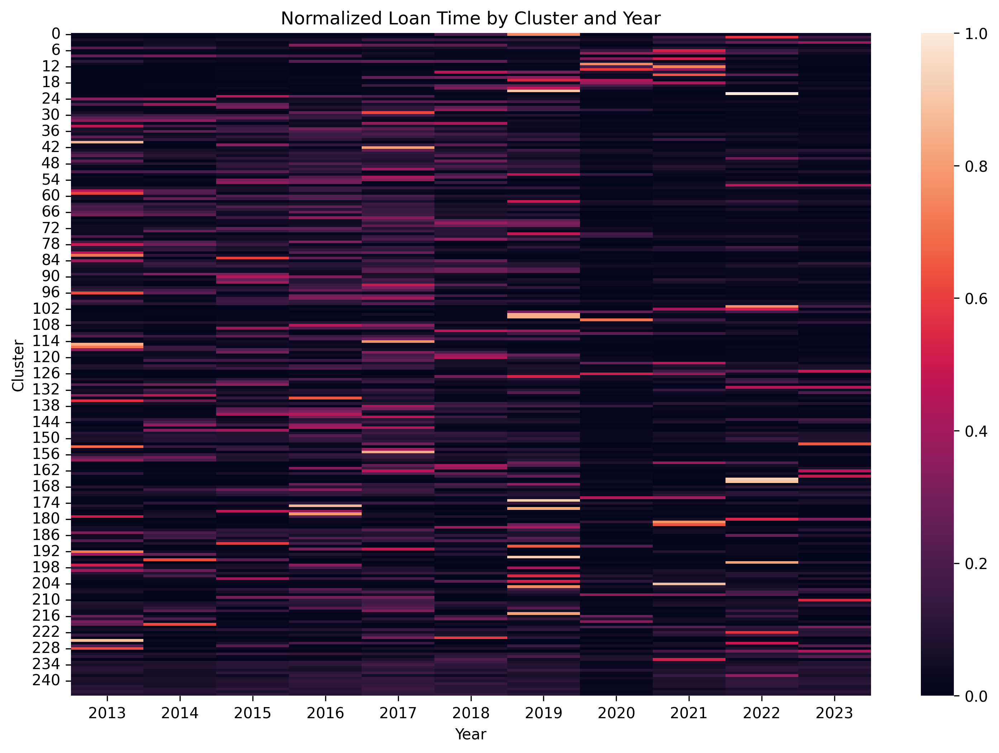

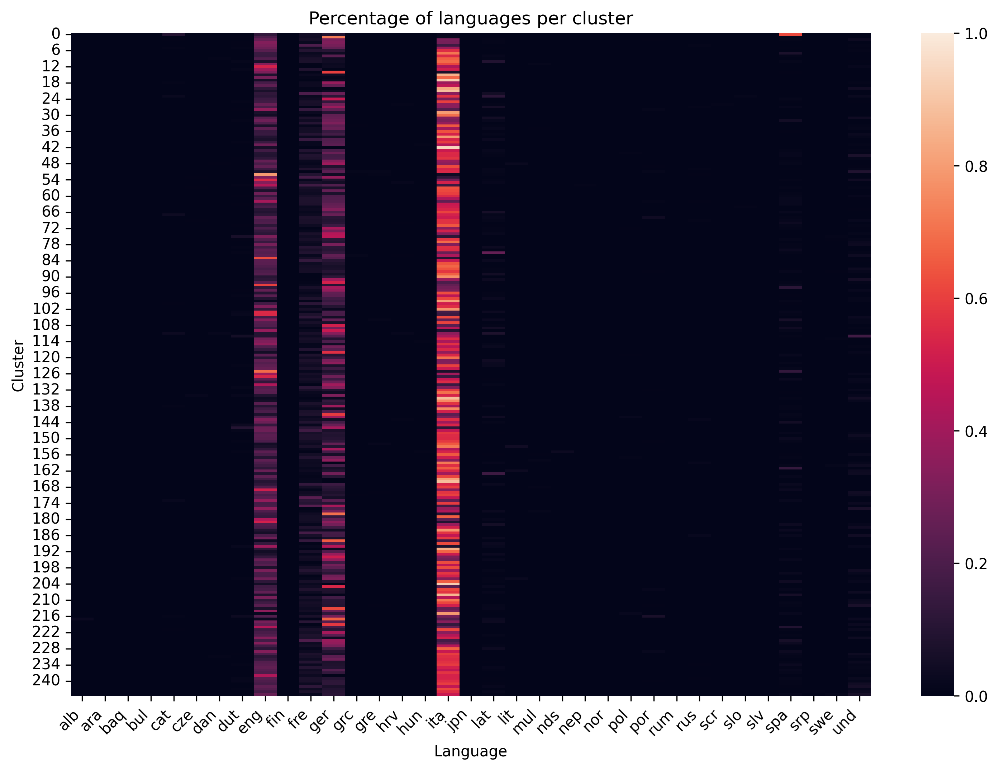

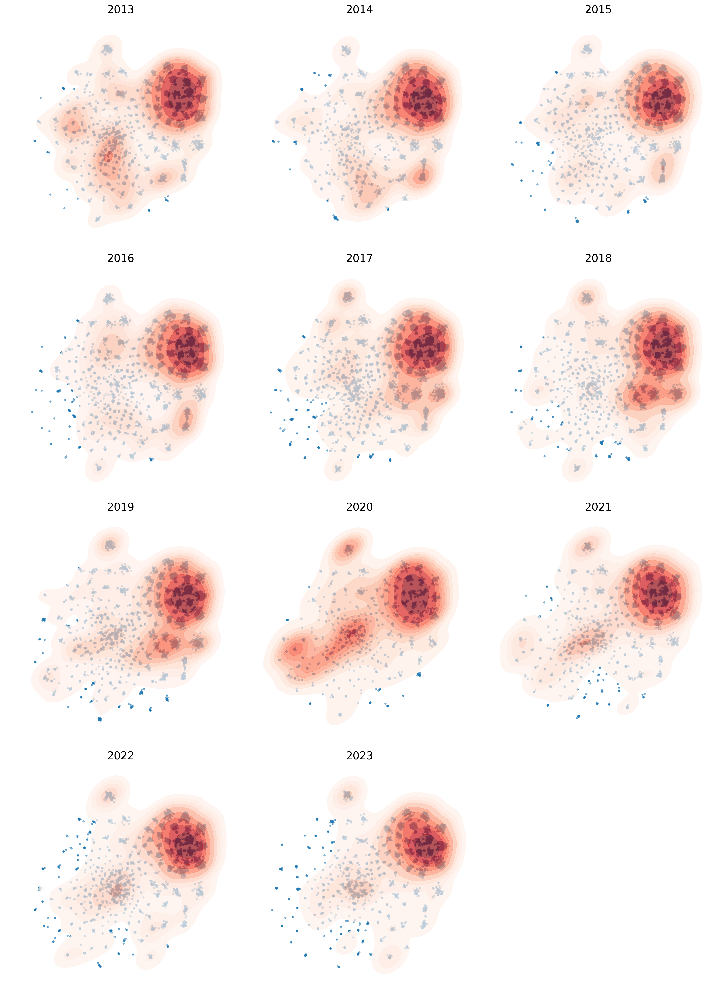

In [3]:
internal_clustered['Subject'] = internal_clustered.Z30_CALL_NO.apply(lambda x: module.get_subject(str(x)))
module.small_multiple_subject(internal_clustered)
module.subject_heatmap(internal_clustered)
module.temporality_heatmap(internal_clustered)
module.language_heatmap(internal_clustered)
module.plot_loan_density(internal_clustered)

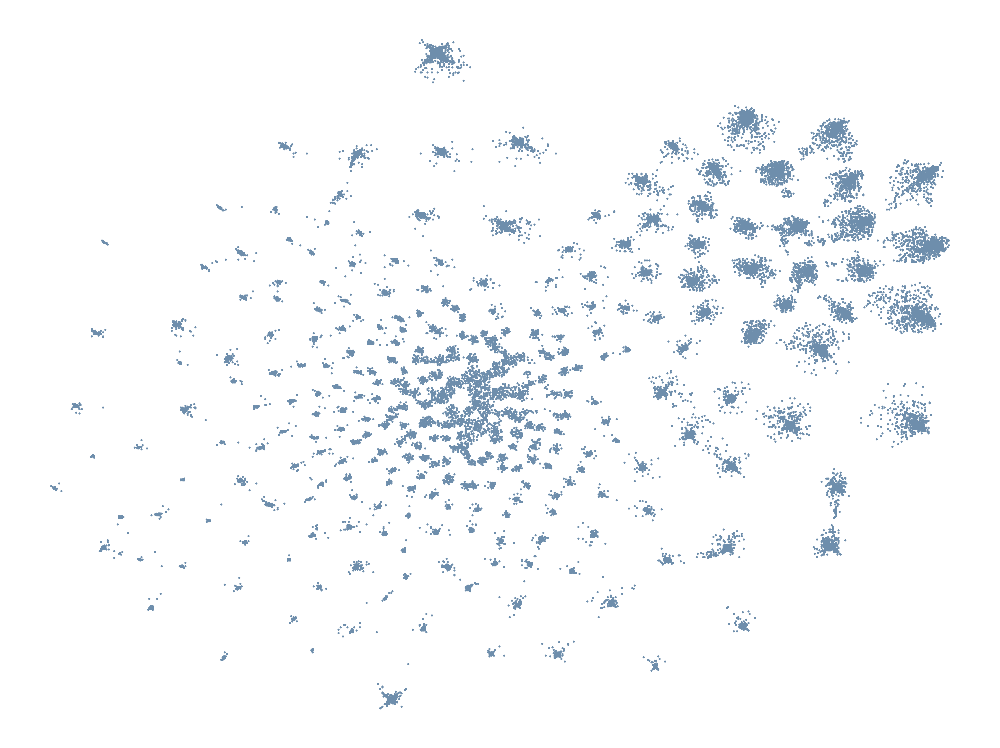

In [7]:
df = internal_clustered

plt.figure(figsize=(20, 15), dpi=300)
plt.scatter(df['x'], df['y'], s=2, c=module.CUSTOM_COLOURS[10])

for cluster_number in np.unique(internal_clustered.cluster):
    if cluster_number != -1:
        cluster_indices = np.where(df.cluster == cluster_number)[0]
        cluster_x = df.iloc[cluster_indices]['x'].mean()
        cluster_y = df.iloc[cluster_indices]['y'].mean()
        # plt.text(cluster_x, cluster_y, str(cluster_number), fontsize=14, ha='center', fontname='Helvetica', color='black')

# plt.text(0.05, 0.95, 'HDBSCAN clustering', transform=plt.gca().transAxes, fontsize=16, ha='left', fontname='Helvetica')
plt.axis('off')
plt.show()


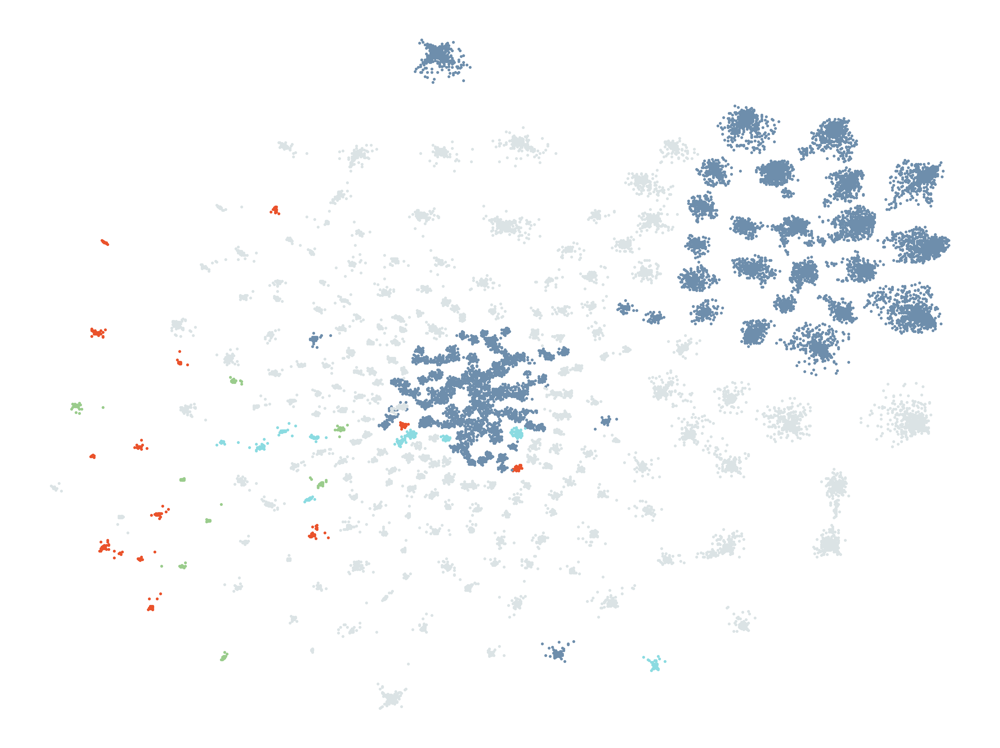

In [14]:
clusters_michalsky = [0, 92, 5, 12, 11, 19, 20, 16, 17, 29, 27, 204, 215]
clusters_weddigen = [1, 6, 7, 13, 15, 33 , 102, 106,  ]

# Clearly identifiable clusters, not assignable to any of the above departments
clusters_others = [3,203, 222, 224, 101, 103, 105, 104, 56]

# General clusters
clusters_general = [2, 8, 200, 201,202, 206, 207, 211, 212, 213, 214, 216, 217, 218, 221, 223, 226, 227, 228, 229, 107, 
                    118, 119 , 123, 124, 148, 151, 57, 156, 171]
# append all clusters from 230 to 246 to the general clusters
clusters_general = np.append(clusters_general, np.arange(230, 246))


df = internal_clustered
plt.figure(figsize=(20, 15), dpi=300)

indices_m = np.where(df['cluster'].isin(clusters_michalsky))[0]
plt.scatter(df.iloc[indices_m]['x'], df.iloc[indices_m]['y'], s=5, c=module.CUSTOM_COLOURS[0])
indices_w = np.where(df['cluster'].isin(clusters_weddigen))[0]
plt.scatter(df.iloc[indices_w]['x'], df.iloc[indices_w]['y'], s=5, c=module.CUSTOM_COLOURS[15])
indices_o = np.where(df['cluster'].isin(clusters_others))[0]
plt.scatter(df.iloc[indices_o]['x'], df.iloc[indices_o]['y'], s=5, c=module.CUSTOM_COLOURS[3])
indices_g = np.where(df['cluster'].isin(clusters_general))[0]
plt.scatter(df.iloc[indices_g]['x'], df.iloc[indices_g]['y'], s=5, c=module.CUSTOM_COLOURS[10])
# indices of all other clusters, in none of the arrays above
indices_other = np.where(~df['cluster'].isin(np.concatenate([clusters_michalsky, clusters_weddigen, clusters_others, clusters_general])))[0]
plt.scatter(df.iloc[indices_other]['x'], df.iloc[indices_other]['y'], s=5, c=module.CUSTOM_COLOURS[19])

plt.axis('off')
plt.show()


# Export titles and clusters 

In [14]:
def to_cluster_df(df):
    cluster_numbers = []
    cluster_xs = []
    cluster_ys = []
    cluster_users = []
    cluster_size = []
    cluster_books = []
    cluster_titles = []


    for cluster_number in np.unique(df.cluster.unique()):
        if cluster_number == -1:
            continue  # Skip outliers which are labelled as -1
        
        cluster_indices = np.where(df.cluster== cluster_number)[0]
        rows = df.iloc[cluster_indices]   
        cluster_x = rows['x'].mean()
        cluster_y = rows['y'].mean()
        users = rows['users'].explode().unique().tolist()
        size = len(users)
        titles = ','.join(rows['title'])
        books = len(rows)


        cluster_numbers.append(cluster_number)
        cluster_xs.append(cluster_x)
        cluster_ys.append(cluster_y)
        cluster_users.append(users)
        cluster_size.append(size)
        cluster_titles.append(titles)
        cluster_books.append(books)


    clusters_df = pd.DataFrame({
        'cluster': cluster_numbers,
        'x': cluster_xs,
        'y': cluster_ys,
        'users': cluster_users, 
        'nr_users': cluster_size, 
        'nr_books': cluster_books,
        'titles': cluster_titles
    })

    return clusters_df

clusters_i = to_cluster_df(internal_clustered)
# clusters_e = to_cluster_df(external_clustered)

In [15]:
clusters_i.to_csv('data/clusters_i.csv', index=False, encoding='utf-8')
# clusters_e.to_csv('exp/clusters_e.csv', index=False)

In [12]:
internal.to_csv('data/internal_embedding.csv', index=False)